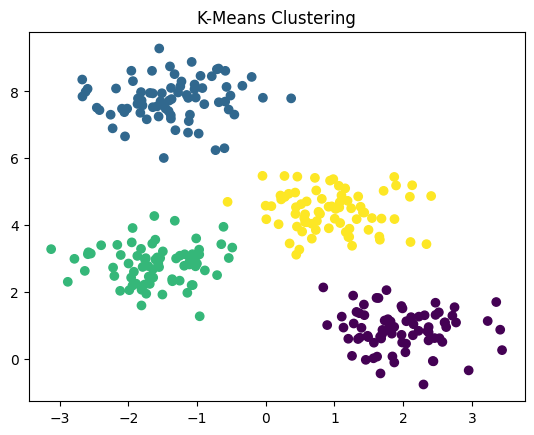

In [1]:


from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs
import matplotlib.pyplot as plt
import seaborn as sns

#ignore warnings
import warnings
warnings.filterwarnings("ignore")

# generate sample data
X, y_true = make_blobs(n_samples=300, centers=4, cluster_std=0.6, random_state=0)

# initiate a KMeans object with the number of clusters
kmeans = KMeans(n_clusters=4)
# fit the data to the KMeans algorithm
kmeans.fit(X)

# get the predicted cluster labels for each data point
labels = kmeans.labels_

# plot the data points with different colors for different clusters
plt.scatter(X[:, 0], X[:, 1], c=labels)
plt.title('K-Means Clustering')
plt.show()



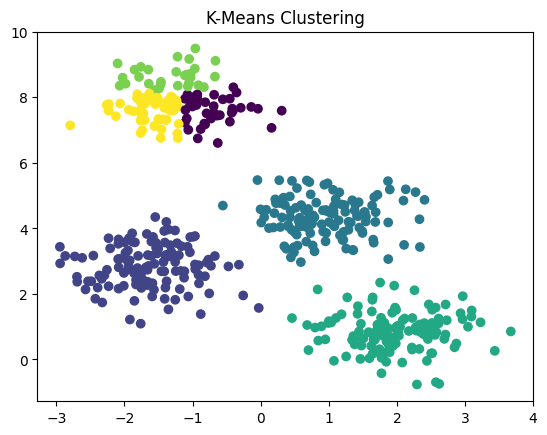

In [2]:
# generate sample data
X, y_true = make_blobs(n_samples=500, centers=4, cluster_std=0.6, random_state=0)

# initiate a KMeans object with the number of clusters
kmeans = KMeans(n_clusters=6)
# fit the data to the KMeans algorithm
kmeans.fit(X)

# get the predicted cluster labels for each data point
labels = kmeans.labels_

# plot the data points with different colors for different clusters
plt.scatter(X[:, 0], X[:, 1], c=labels)
plt.title('K-Means Clustering')
plt.show()


In [3]:
diamond = sns.load_dataset('diamonds')
diamond.head(3)

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31


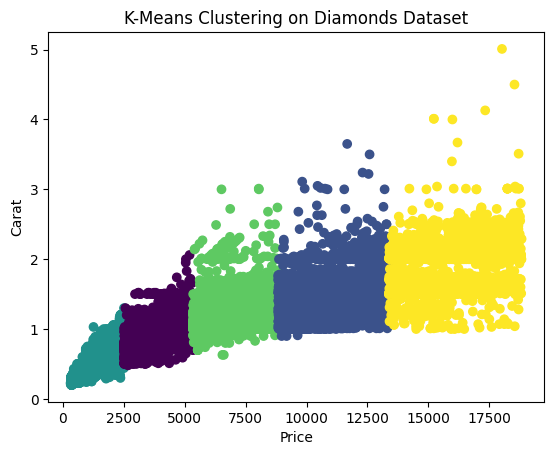

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans

from sklearn.preprocessing import StandardScaler
X = diamond[['price', 'carat']]

kmeans = KMeans(n_clusters=5)
kmeans.fit(X)
# Get the predicted cluster labels for each data point
labels = kmeans.labels_

# Add predicted cluster labels as a new column to the original dataset
diamond['labels'] = labels

# Plot the data points with different colors for different clusters
plt.scatter(X.iloc[:, 0], X.iloc[:, 1], c=labels)
plt.xlabel("Price")
plt.ylabel("Carat")
plt.title('K-Means Clustering on Diamonds Dataset')
plt.show()

<Axes: xlabel='labels', ylabel='price'>

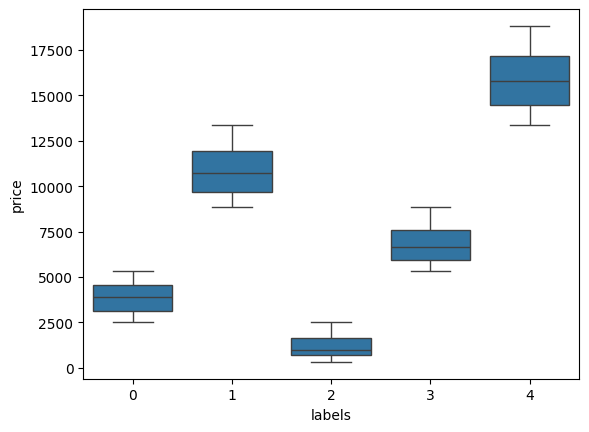

In [5]:
sns.boxplot(x='labels', y='price', data=diamond)

In [6]:
diamond.labels.unique()

array([2, 0, 3, 1, 4])

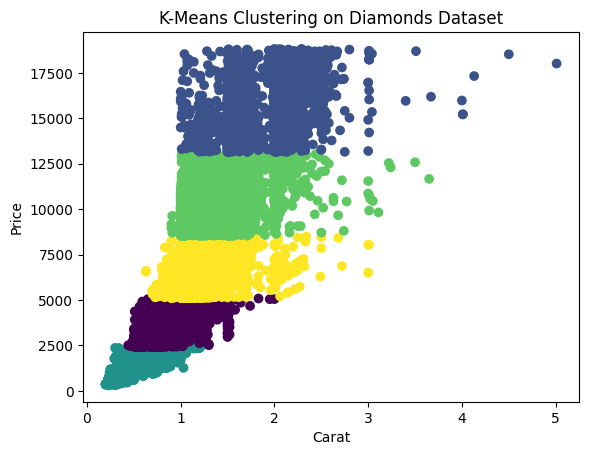

In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans

# Select relevant columns
X = diamond[["carat", "price", "cut", "color", "clarity"]]

# Convert categorical variables to numerical using one-hot encoding
X = pd.get_dummies(X)

# Instantiate a KMeans object with the number of clusters
kmeans = KMeans(n_clusters=5)

# Fit the data to the KMeans algorithm
kmeans.fit(X)

# Get the predicted cluster labels for each data point
labels = kmeans.labels_

# Add predicted cluster labels as a new column to the original dataset
diamond['labels'] = labels

# Plot the data points with different colors for different clusters
plt.scatter(X.iloc[:, 0], X.iloc[:, 1], c=labels)
plt.xlabel("Carat")
plt.ylabel("Price")
plt.title('K-Means Clustering on Diamonds Dataset')
plt.show()

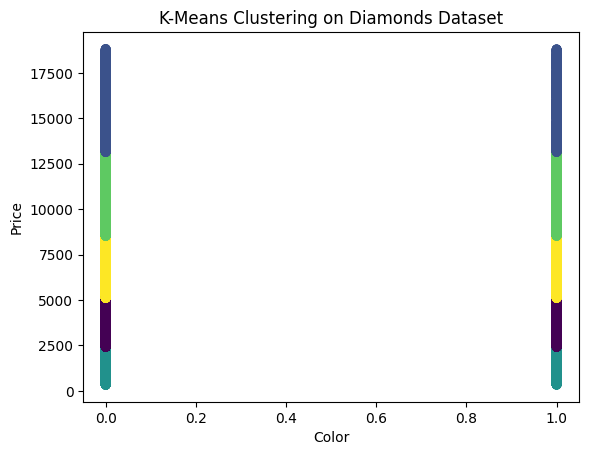

In [8]:
# Plot the data points with different colors for different clusters
plt.scatter(X.iloc[:, 2], X.iloc[:, 1], c=labels)
plt.xlabel("Color")
plt.ylabel("Price")
plt.title('K-Means Clustering on Diamonds Dataset')
plt.show()

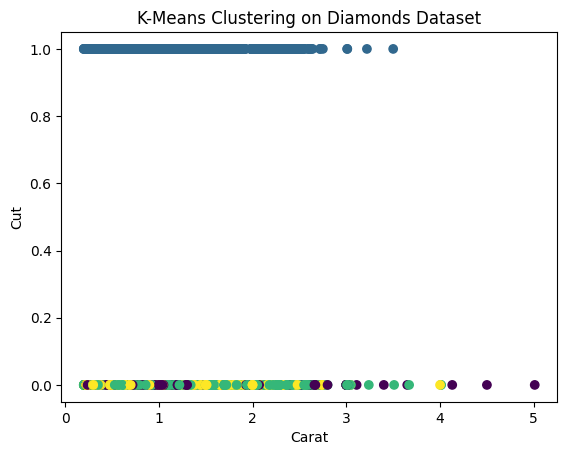

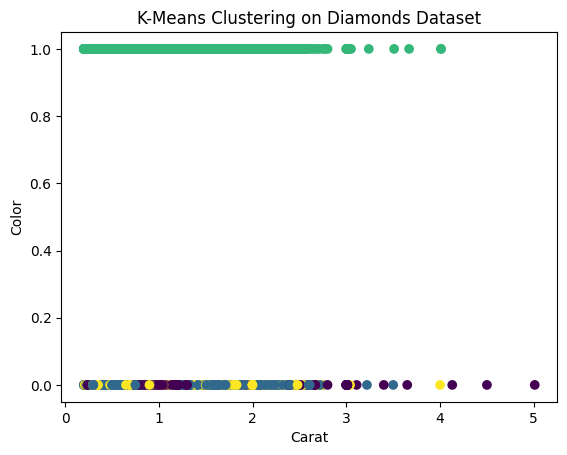

In [9]:
# Select relevant columns
X = diamond[["carat", "cut", "color"]]

# Convert categorical variables to numerical using one-hot encoding
X = pd.get_dummies(X)

# Instantiate a KMeans object with the number of clusters
kmeans = KMeans(n_clusters=4)

# Fit the data to the KMeans algorithm
kmeans.fit(X)

# Get the predicted cluster labels for each data point
labels = kmeans.labels_

# Add predicted cluster labels as a new column to the original dataset
diamond['labels'] = labels

# Plot the data points with different colors for different clusters
plt.scatter(X.iloc[:, 0], X.iloc[:, 1], c=labels, cmap='viridis')
plt.xlabel("Carat")
plt.ylabel("Cut")
plt.title('K-Means Clustering on Diamonds Dataset')
plt.show()

plt.scatter(X.iloc[:, 0], X.iloc[:, 2], c=labels, cmap='viridis')
plt.xlabel("Carat")
plt.ylabel("Color")
plt.title('K-Means Clustering on Diamonds Dataset')
plt.show()

In [10]:
# Select relevant columns
X = diamond[["carat", "price"]]

# Instantiate a KMeans object with the number of clusters
kmeans = KMeans(n_clusters=5)

# Fit the data to the KMeans algorithm
kmeans.fit(X)

# Get the predicted cluster labels for each data point
labels = kmeans.predict(X)

# Add predicted cluster labels as a new column to the original dataset
diamond['labels'] = labels

# Display the first few rows of the dataset with the new column added
print(diamond.head())

#display the unique values of a label
print("These are the unique values of labels: ", sorted(diamond.labels.unique()))

   carat      cut color clarity  depth  table  price     x     y     z  labels
0   0.23    Ideal     E     SI2   61.5   55.0    326  3.95  3.98  2.43       2
1   0.21  Premium     E     SI1   59.8   61.0    326  3.89  3.84  2.31       2
2   0.23     Good     E     VS1   56.9   65.0    327  4.05  4.07  2.31       2
3   0.29  Premium     I     VS2   62.4   58.0    334  4.20  4.23  2.63       2
4   0.31     Good     J     SI2   63.3   58.0    335  4.34  4.35  2.75       2
These are the unique values of labels:  [0, 1, 2, 3, 4]


In [11]:
import plotly.express as px
fig = px.parallel_coordinates(diamond, color="labels")
fig.show() 

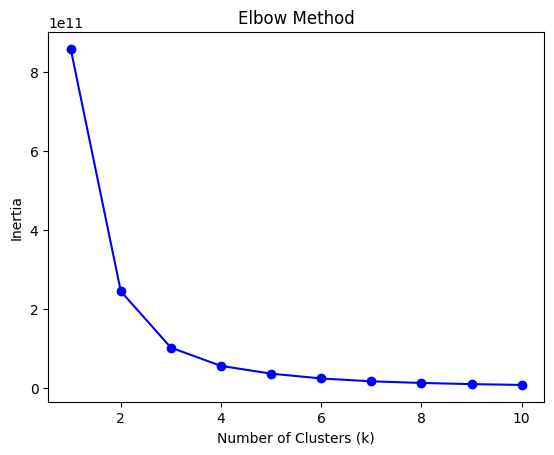

In [12]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans



# Select relevant features for clustering
features = ['carat', 'depth', 'price']

# Extract the selected features from the dataset
X = diamond[features]

# Perform K-means clustering for different values of k
k_values = range(1, 11)  # Test k from 1 to 10
inertias = []  # List to store the inertia values

for k in k_values:
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(X)
    inertias.append(kmeans.inertia_)

# Plot the Elbow curve
plt.plot(k_values, inertias, 'bo-')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.title('Elbow Method')
plt.show()



In [13]:
import plotly.express as px
import pandas as pd
import webbrowser

# Sample data for testing
#diamonds = px.data.diamonds()

fig = px.parallel_coordinates(diamond, color="price")
fig.write_html("plot.html")

# Open the plot in the default web browser
webbrowser.open("plot.html")


True

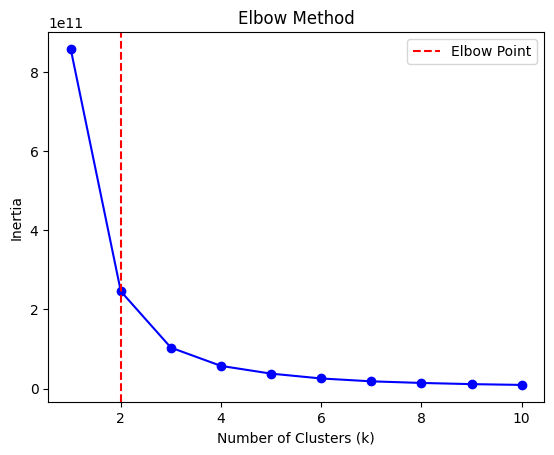

The best number of clusters based on the Elbow Method is: 2


In [14]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans


# Select relevant features for clustering
features = ['carat', 'depth', 'price']

# Extract the selected features from the dataset
X = diamond[features]

# Perform K-means clustering for different values of k
k_values = range(1, 11)  # Test k from 1 to 10
inertias = []  # List to store the inertia values

for k in k_values:
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(X)
    inertias.append(kmeans.inertia_)

# Plot the Elbow curve
plt.plot(k_values, inertias, 'bo-')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.title('Elbow Method')

# Find the elbow point
diff = [inertias[i] - inertias[i+1] for i in range(len(inertias)-1)]
best_k = diff.index(max(diff)) + 2

# Add a vertical line to indicate the elbow point
plt.axvline(x=best_k, color='r', linestyle='--', label='Elbow Point')

plt.legend()
plt.show()

print("The best number of clusters based on the Elbow Method is:", best_k)

In [15]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Load the Diamonds dataset
df = sns.load_dataset('diamonds')

# Select relevant features for clustering
features = ['carat', 'depth', 'price']

# Extract the selected features from the dataset
X = df[features]

# Perform K-means clustering with K-means++
k = 3  # Number of clusters
kmeans_pp = KMeans(n_clusters=k, init='k-means++', random_state=42)
kmeans_pp.fit(X)

# Perform standard K-means clustering
kmeans = KMeans(n_clusters=k, random_state=42)
kmeans.fit(X)

# Add cluster labels to the dataset
df['cluster_pp'] = kmeans_pp.labels_
df['cluster'] = kmeans.labels_

df.head()

,carat,cut,color,clarity,depth,table,price,x,y,z,cluster_pp,cluster
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43,1,1
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31,1,1
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31,1,1
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63,1,1
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75,1,1


In [16]:
df.cluster.value_counts()

cluster
1    32851
2    15374
0     5715
Name: count, dtype: int64

In [17]:
df.cluster_pp.value_counts()

cluster_pp
1    32851
2    15374
0     5715
Name: count, dtype: int64

In [18]:
df.columns

Index(['carat', 'cut', 'color', 'clarity', 'depth', 'table', 'price', 'x', 'y',
       'z', 'cluster_pp', 'cluster'],
      dtype='object')

In [19]:
# make a 3d plot in plotly
fig = px.scatter_3d(df, x='carat', y='depth', z='price', color='cluster_pp')
fig.show()

In [20]:
fig = px.parallel_coordinates(df, color='cluster_pp')
fig.show()

In [21]:
kmeans.inertia_

103352717498.12894

In [22]:
flower = sns.load_dataset('iris')
flower.drop('species', axis=1, inplace=True)
flower.head()

,sepal_length,sepal_width,petal_length,petal_width
0,5.1,3.5,1.4,0.2
1,4.9,3.0,1.4,0.2
2,4.7,3.2,1.3,0.2
3,4.6,3.1,1.5,0.2
4,5.0,3.6,1.4,0.2


In [23]:
# run kmeans clustering on df
kmeans = KMeans(n_clusters=3, init='k-means++', random_state=42)
kmeans.fit(flower)

# Add cluster labels to the dataset
flower['cluster'] = kmeans.labels_

flower.head()

,sepal_length,sepal_width,petal_length,petal_width,cluster
0,5.1,3.5,1.4,0.2,1
1,4.9,3.0,1.4,0.2,1
2,4.7,3.2,1.3,0.2,1
3,4.6,3.1,1.5,0.2,1
4,5.0,3.6,1.4,0.2,1


In [25]:
import plotly.express as px
fig = px.scatter(flower, x='sepal_length', y='petal_length', color='cluster')
fig.show()

In [26]:
# let's use plotly and make plots
iris = sns.load_dataset('iris')
import plotly.express as px
fig = px.scatter(iris, x='sepal_length', y='petal_length', color='species')
fig.show()

In [27]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

# Load the Diamonds dataset
df = sns.load_dataset('diamonds')

# Select relevant features for clustering
features = ['carat', 'depth', 'price']

# Extract the selected features from the dataset
X = df[features]

# Perform K-means clustering for different values of k
k_values = range(2, 11)  # Test k from 2 to 10
silhouette_scores = []  # List to store the silhouette scores

for k in k_values:
    kmeans = KMeans(n_clusters=k, init='k-means++')
    kmeans.fit(X)
    labels = kmeans.labels_
    silhouette_scores.append(silhouette_score(X, labels))

# Plot the Silhouette scores
plt.plot(k_values, silhouette_scores, 'bo-')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Method')
# Find the best number of clusters based on the Silhouette Method
best_k = k_values[silhouette_scores.index(max(silhouette_scores))]

# Add a vertical line to indicate the best number of clusters
plt.axvline(x=best_k, color='r', linestyle='--', label='Best Number of Clusters')

plt.legend()
plt.show()

print("The best number of clusters based on the Silhouette Method is:", best_k)

MemoryError: Unable to allocate 1.00 GiB for an array with shape (2488, 53940) and data type float64

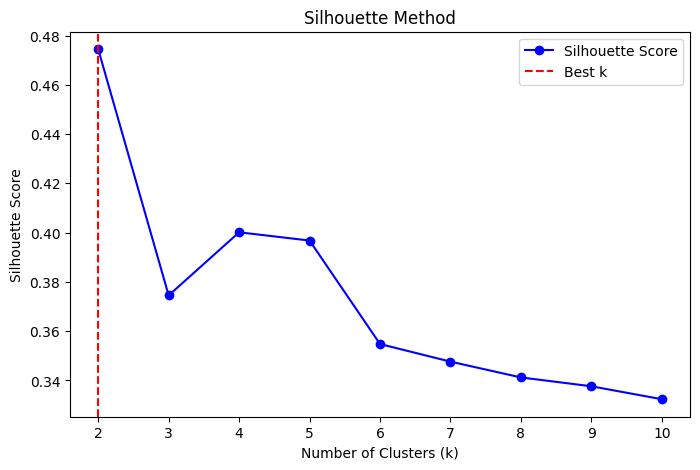

The best number of clusters based on the Silhouette Method is: 2


In [32]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler

# Load the Diamonds dataset
df = sns.load_dataset('diamonds')

# Select relevant features for clustering
features = ['carat', 'depth', 'price']
df = df[features].dropna()  # Drop missing values

# Sample a subset to avoid memory issues
df_sample = df.sample(n=5000, random_state=42)

# Standardize the data
scaler = StandardScaler()
X = scaler.fit_transform(df_sample)

# Perform K-means clustering for different values of k
k_values = range(2, 11)
silhouette_scores = []

for k in k_values:
    kmeans = KMeans(n_clusters=k, init='k-means++', random_state=42, n_init=10)
    kmeans.fit(X)
    labels = kmeans.labels_
    silhouette_scores.append(silhouette_score(X, labels))

# Plot the Silhouette scores
plt.figure(figsize=(8, 5))
plt.plot(k_values, silhouette_scores, 'bo-', label='Silhouette Score')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Method')
plt.axvline(x=k_values[silhouette_scores.index(max(silhouette_scores))], color='r', linestyle='--', label='Best k')
plt.legend()
plt.show()

print("The best number of clusters based on the Silhouette Method is:", k_values[silhouette_scores.index(max(silhouette_scores))])


In [28]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import datasets
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
from sklearn.metrics import calinski_harabasz_score, davies_bouldin_score
from gap_statistic import OptimalK  # Requires installing gap-statistic library

# Load the Iris dataset
iris = datasets.load_iris()
X = iris.data

# Define range of clusters
cluster_range = range(2, 11)

# Store results
ch_scores = []
db_scores = []
bic_scores = []
gap_values = []

# Compute Gap Statistic
optimalK = OptimalK(parallel_backend='joblib')
gap_k = optimalK(X, cluster_range)

for k in cluster_range:
    # K-Means Clustering
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10).fit(X)
    labels = kmeans.labels_
    
    # Gaussian Mixture Model (for BIC calculation)
    gmm = GaussianMixture(n_components=k, random_state=42).fit(X)
    bic_scores.append(gmm.bic(X))
    
    # Compute Metrics
    ch_scores.append(calinski_harabasz_score(X, labels))
    db_scores.append(davies_bouldin_score(X, labels))
    
# Plot the results
fig, ax = plt.subplots(2, 2, figsize=(12, 10))
ax[0, 0].plot(cluster_range, ch_scores, marker='o', label='CH Score')
ax[0, 0].set_title('Calinski-Harabasz Score')
ax[0, 0].set_xlabel('Number of Clusters')
ax[0, 0].set_ylabel('Score')
ax[0, 0].legend()

ax[0, 1].plot(cluster_range, db_scores, marker='o', label='DB Score')
ax[0, 1].set_title('Davies-Bouldin Score')
ax[0, 1].set_xlabel('Number of Clusters')
ax[0, 1].set_ylabel('Score')
ax[0, 1].legend()

ax[1, 0].plot(cluster_range, gap_k.values(), marker='o', label='Gap Statistic')
ax[1, 0].set_title('Gap Statistic')
ax[1, 0].set_xlabel('Number of Clusters')
ax[1, 0].set_ylabel('Score')
ax[1, 0].legend()

ax[1, 1].plot(cluster_range, bic_scores, marker='o', label='BIC Score')
ax[1, 1].set_title('Bayesian Information Criterion (BIC)')
ax[1, 1].set_xlabel('Number of Clusters')
ax[1, 1].set_ylabel('Score')
ax[1, 1].legend()

plt.tight_layout()
plt.show()


ModuleNotFoundError: No module named 'gap_statistic'

In [29]:
pip install gap_statictics

Note: you may need to restart the kernel to use updated packages.


ERROR: Could not find a version that satisfies the requirement gap_statictics (from versions: none)

[notice] A new release of pip is available: 24.2 -> 25.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip
ERROR: No matching distribution found for gap_statictics


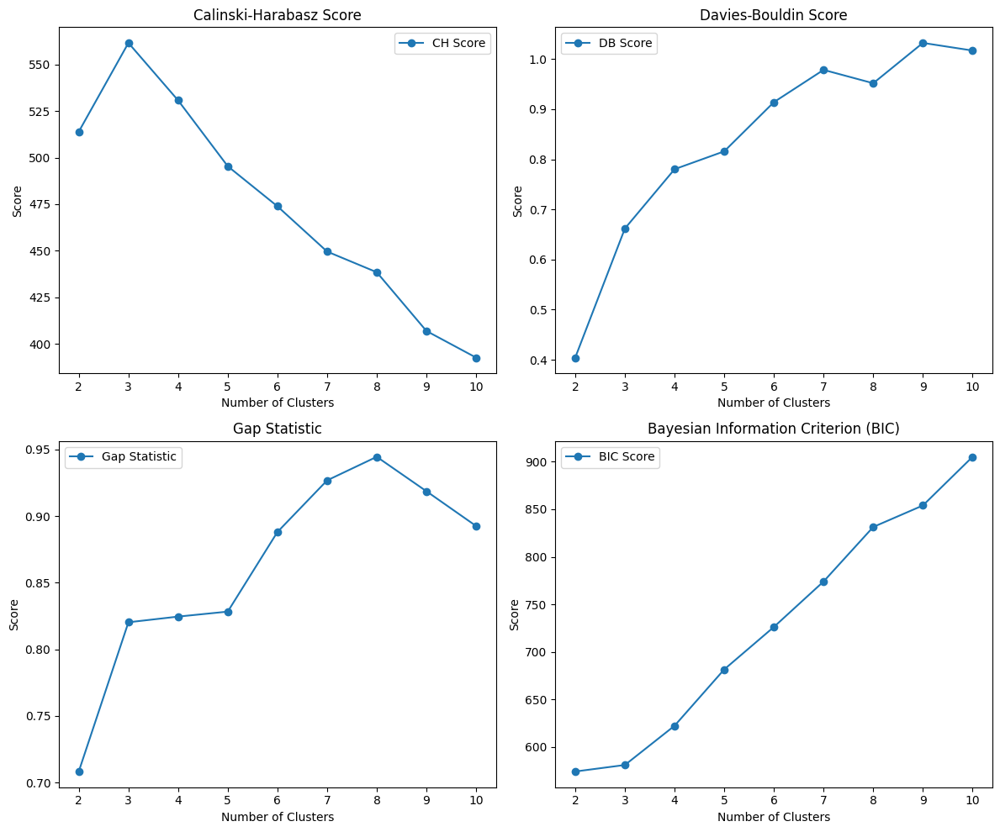

In [30]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import datasets
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
from sklearn.metrics import calinski_harabasz_score, davies_bouldin_score
from scipy.spatial.distance import cdist

# Load the Iris dataset
iris = datasets.load_iris()
X = iris.data

# Define range of clusters
cluster_range = range(2, 11)

# Store results
ch_scores = []
db_scores = []
bic_scores = []
gap_values = []

# Compute Gap Statistic manually
def compute_gap_statistic(X, cluster_range):
    gaps = []
    for k in cluster_range:
        kmeans = KMeans(n_clusters=k, random_state=42, n_init=10).fit(X)
        labels = kmeans.labels_
        intra_dist = np.mean([cdist(X[labels == i], [kmeans.cluster_centers_[i]], 'euclidean').mean() for i in range(k)])
        
        ref_data = np.random.uniform(X.min(axis=0), X.max(axis=0), size=X.shape)
        ref_kmeans = KMeans(n_clusters=k, random_state=42, n_init=10).fit(ref_data)
        ref_intra_dist = np.mean([cdist(ref_data[ref_kmeans.labels_ == i], [ref_kmeans.cluster_centers_[i]], 'euclidean').mean() for i in range(k)])
        
        gap = np.log(ref_intra_dist) - np.log(intra_dist)
        gaps.append(gap)
    return gaps

gap_values = compute_gap_statistic(X, cluster_range)

for k in cluster_range:
    # K-Means Clustering
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10).fit(X)
    labels = kmeans.labels_
    
    # Gaussian Mixture Model (for BIC calculation)
    gmm = GaussianMixture(n_components=k, random_state=42).fit(X)
    bic_scores.append(gmm.bic(X))
    
    # Compute Metrics
    ch_scores.append(calinski_harabasz_score(X, labels))
    db_scores.append(davies_bouldin_score(X, labels))
    
# Plot the results
fig, ax = plt.subplots(2, 2, figsize=(12, 10))
ax[0, 0].plot(cluster_range, ch_scores, marker='o', label='CH Score')
ax[0, 0].set_title('Calinski-Harabasz Score')
ax[0, 0].set_xlabel('Number of Clusters')
ax[0, 0].set_ylabel('Score')
ax[0, 0].legend()

ax[0, 1].plot(cluster_range, db_scores, marker='o', label='DB Score')
ax[0, 1].set_title('Davies-Bouldin Score')
ax[0, 1].set_xlabel('Number of Clusters')
ax[0, 1].set_ylabel('Score')
ax[0, 1].legend()

ax[1, 0].plot(cluster_range, gap_values, marker='o', label='Gap Statistic')
ax[1, 0].set_title('Gap Statistic')
ax[1, 0].set_xlabel('Number of Clusters')
ax[1, 0].set_ylabel('Score')
ax[1, 0].legend()

ax[1, 1].plot(cluster_range, bic_scores, marker='o', label='BIC Score')
ax[1, 1].set_title('Bayesian Information Criterion (BIC)')
ax[1, 1].set_xlabel('Number of Clusters')
ax[1, 1].set_ylabel('Score')
ax[1, 1].legend()

plt.tight_layout()
plt.show()


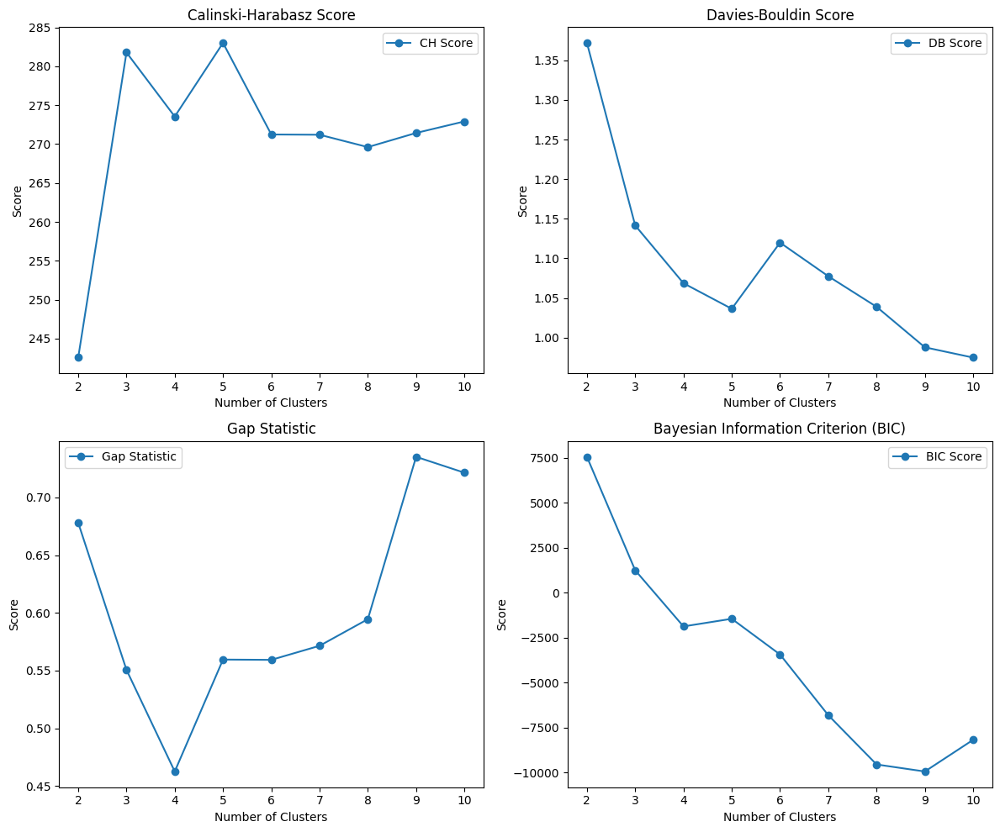

In [31]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
from sklearn.metrics import calinski_harabasz_score, davies_bouldin_score
from scipy.spatial.distance import cdist
from sklearn.preprocessing import StandardScaler

# Load the Titanic dataset
titanic = pd.read_csv('https://raw.githubusercontent.com/datasciencedojo/datasets/master/titanic.csv')

# Select relevant features (numeric only)
numeric_features = ['Age', 'Fare', 'Pclass', 'SibSp', 'Parch']
titanic = titanic[numeric_features].dropna()

# Standardize the data
scaler = StandardScaler()
X = scaler.fit_transform(titanic)

# Define range of clusters
cluster_range = range(2, 11)

# Store results
ch_scores = []
db_scores = []
bic_scores = []
gap_values = []

# Compute Gap Statistic manually
def compute_gap_statistic(X, cluster_range):
    gaps = []
    for k in cluster_range:
        kmeans = KMeans(n_clusters=k, random_state=42, n_init=10).fit(X)
        labels = kmeans.labels_
        intra_dist = np.mean([cdist(X[labels == i], [kmeans.cluster_centers_[i]], 'euclidean').mean() for i in range(k)])
        
        ref_data = np.random.uniform(X.min(axis=0), X.max(axis=0), size=X.shape)
        ref_kmeans = KMeans(n_clusters=k, random_state=42, n_init=10).fit(ref_data)
        ref_intra_dist = np.mean([cdist(ref_data[ref_kmeans.labels_ == i], [ref_kmeans.cluster_centers_[i]], 'euclidean').mean() for i in range(k)])
        
        gap = np.log(ref_intra_dist) - np.log(intra_dist)
        gaps.append(gap)
    return gaps

gap_values = compute_gap_statistic(X, cluster_range)

for k in cluster_range:
    # K-Means Clustering
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10).fit(X)
    labels = kmeans.labels_
    
    # Gaussian Mixture Model (for BIC calculation)
    gmm = GaussianMixture(n_components=k, random_state=42).fit(X)
    bic_scores.append(gmm.bic(X))
    
    # Compute Metrics
    ch_scores.append(calinski_harabasz_score(X, labels))
    db_scores.append(davies_bouldin_score(X, labels))
    
# Plot the results
fig, ax = plt.subplots(2, 2, figsize=(12, 10))
ax[0, 0].plot(cluster_range, ch_scores, marker='o', label='CH Score')
ax[0, 0].set_title('Calinski-Harabasz Score')
ax[0, 0].set_xlabel('Number of Clusters')
ax[0, 0].set_ylabel('Score')
ax[0, 0].legend()

ax[0, 1].plot(cluster_range, db_scores, marker='o', label='DB Score')
ax[0, 1].set_title('Davies-Bouldin Score')
ax[0, 1].set_xlabel('Number of Clusters')
ax[0, 1].set_ylabel('Score')
ax[0, 1].legend()

ax[1, 0].plot(cluster_range, gap_values, marker='o', label='Gap Statistic')
ax[1, 0].set_title('Gap Statistic')
ax[1, 0].set_xlabel('Number of Clusters')
ax[1, 0].set_ylabel('Score')
ax[1, 0].legend()

ax[1, 1].plot(cluster_range, bic_scores, marker='o', label='BIC Score')
ax[1, 1].set_title('Bayesian Information Criterion (BIC)')
ax[1, 1].set_xlabel('Number of Clusters')
ax[1, 1].set_ylabel('Score')
ax[1, 1].legend()

plt.tight_layout()
plt.show()
